In [3]:
########### Bring in tools to use in rest of notebook
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as pltp
import plotly.express as px
import json
import requests
import pandas as pd
from scipy import stats
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KernelDensity
############

* * * 
* * *
<h3 align="center">Figures for</h3>

<h1 align="center">Early Cambrian foreland phosphogenesis in the Khuvsgul Basin of Mongolia</h1>

    
<h2 align="center">Anttila et al.</h2>

* * *  

For inquiries, please contact E. Anttila at eanttila@ethz.ch.

* * *
* * *

## _Figure 1:_ created in QGIS/Illustrator, pdf only.
* * * 
_Shapefiles accessible upon request._

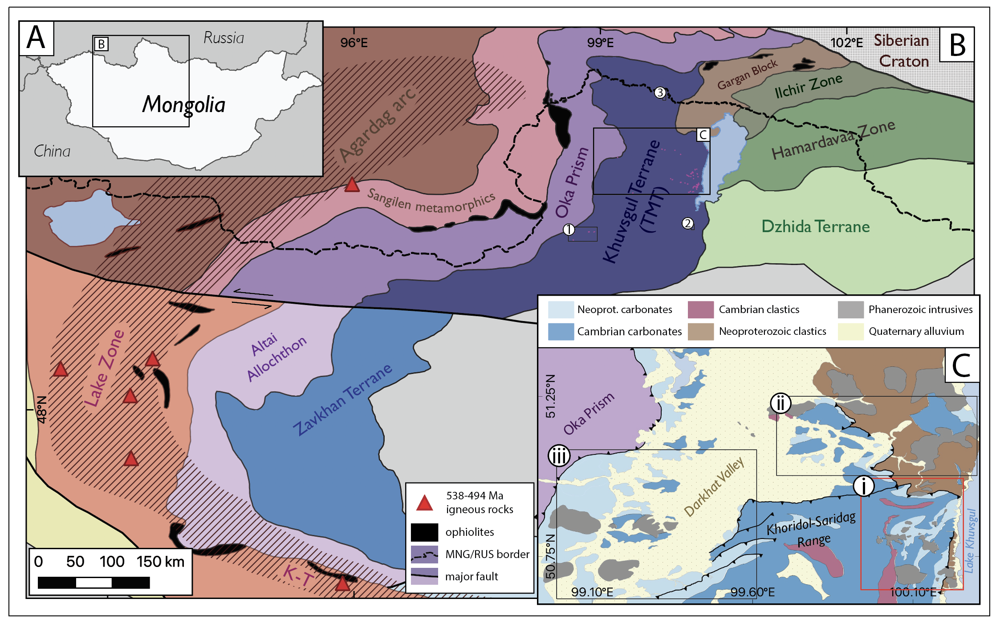

In [3]:
from IPython.display import Image

fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig1.png')
fig

## _Figure 2:_ created in Illustrator, pdf only.
* * * 


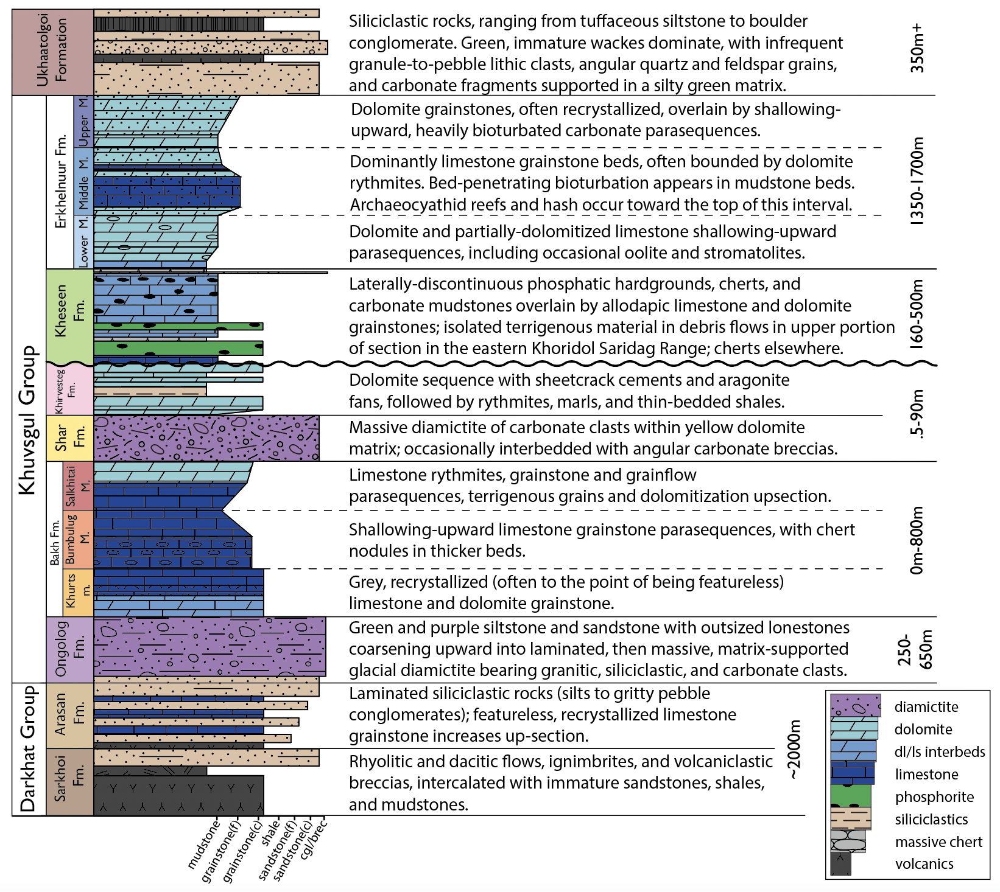

In [4]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig2.png')
fig

## _Figure 3:_ created in QGIS/Illustrator, pdf only.
* * * 
_Shapefiles accessible upon request._

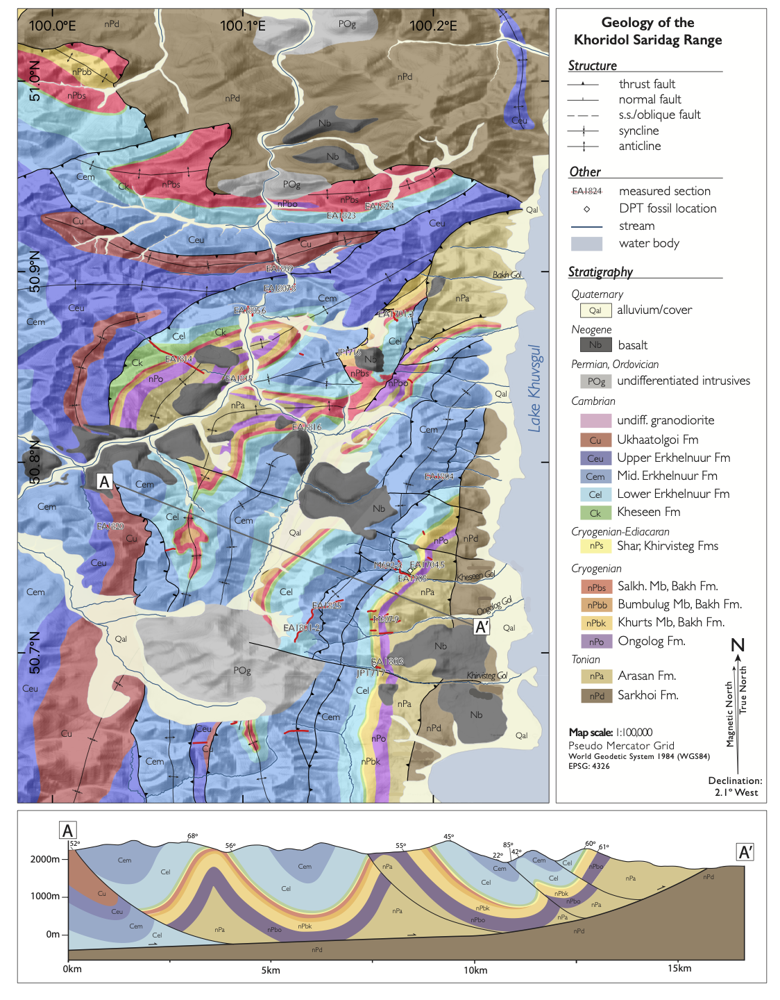

In [5]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig3.png')
fig

## _Figure 4:_ created in Illustrator, pdf only.
* * * 

_All chemostratigraphic data incorporated into plots can be found in /Fig_Code/Chemostrat/Data_

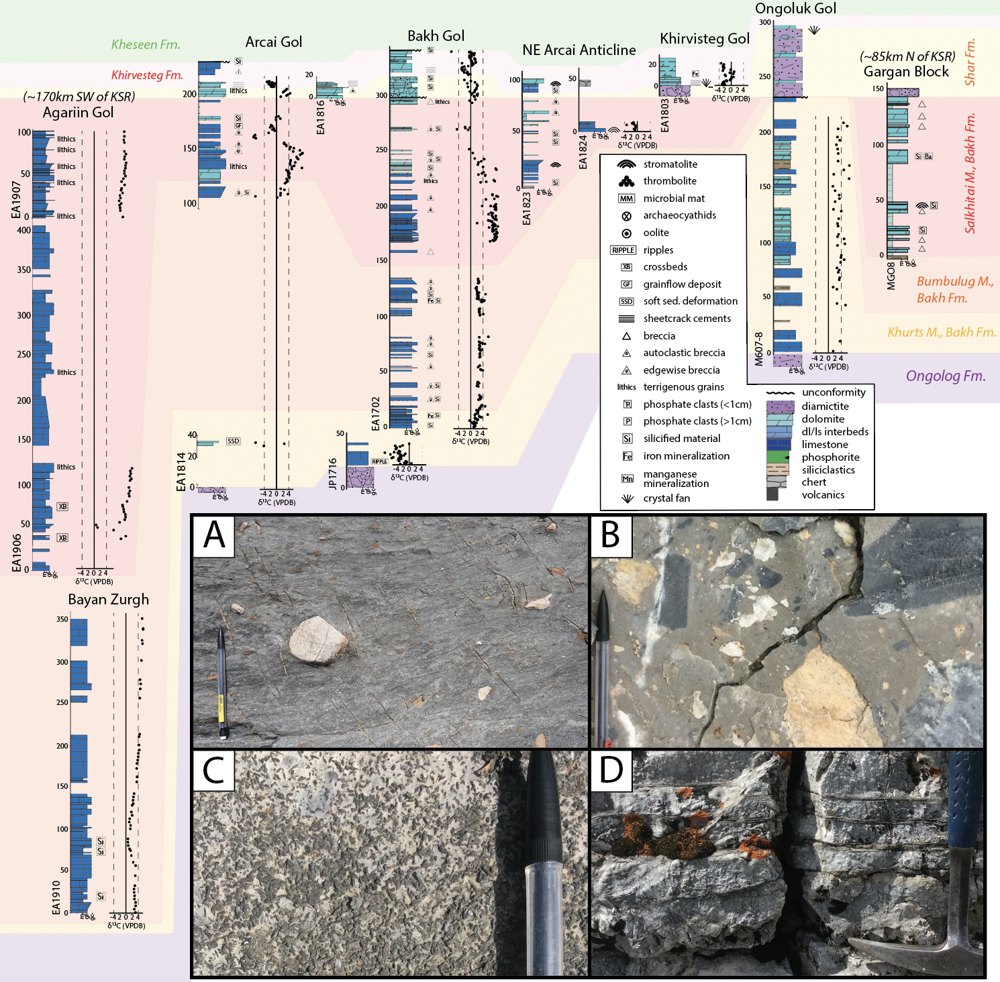

In [6]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig4.png')
fig

## _Figure 5:_ created in Illustrator, pdf only.
* * * 

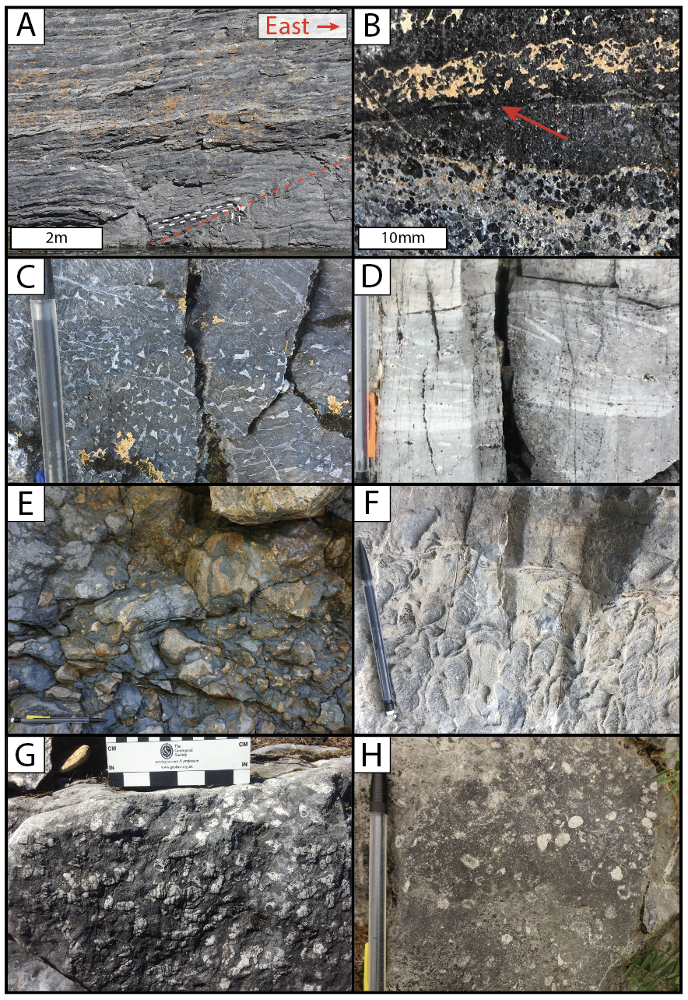

In [7]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig5.png')
fig

## _Figure 6:_ created in Illustrator, pdf only.
* * * 

_All chemostratigraphic data incorporated into plots can be found in /Fig_Code/Chemostrat/Data_

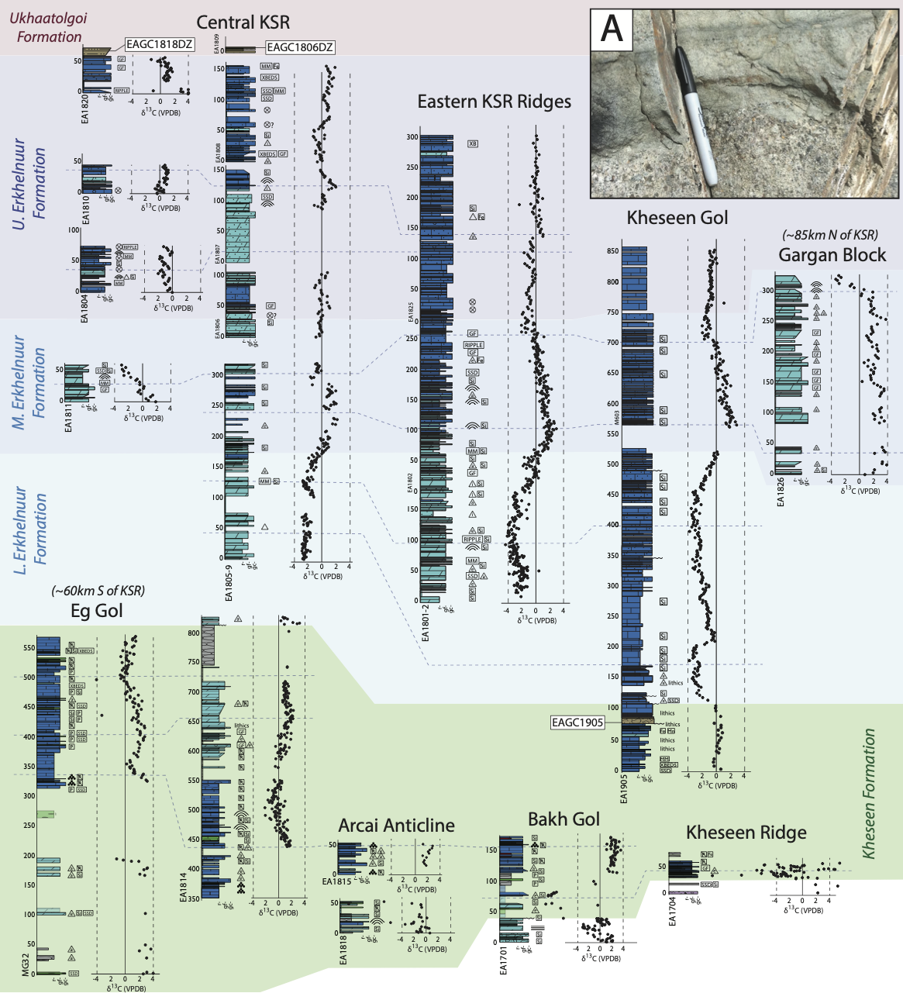

In [8]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig6.png')
fig

## _Figure 7_
* * * 

_for code used to generate stereonets, see /Fig_Code/Structure/Structure.ipynb_

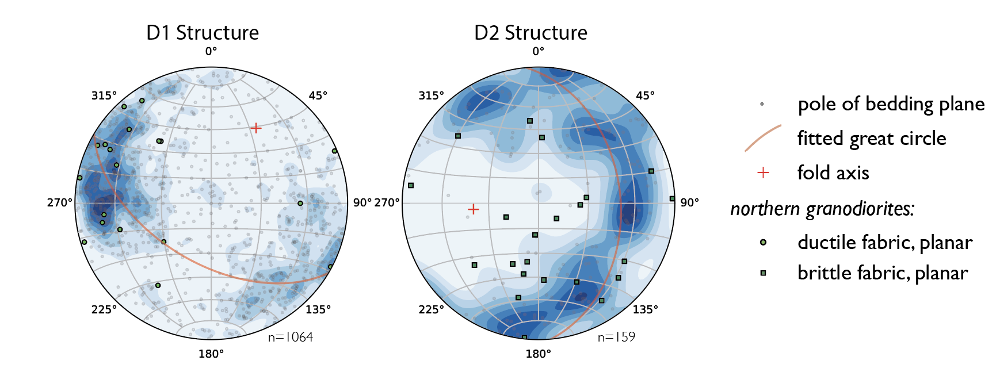

In [9]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig7.png')
fig

## _Figure 8:_ created in Illustrator, pdf only.
* * * 


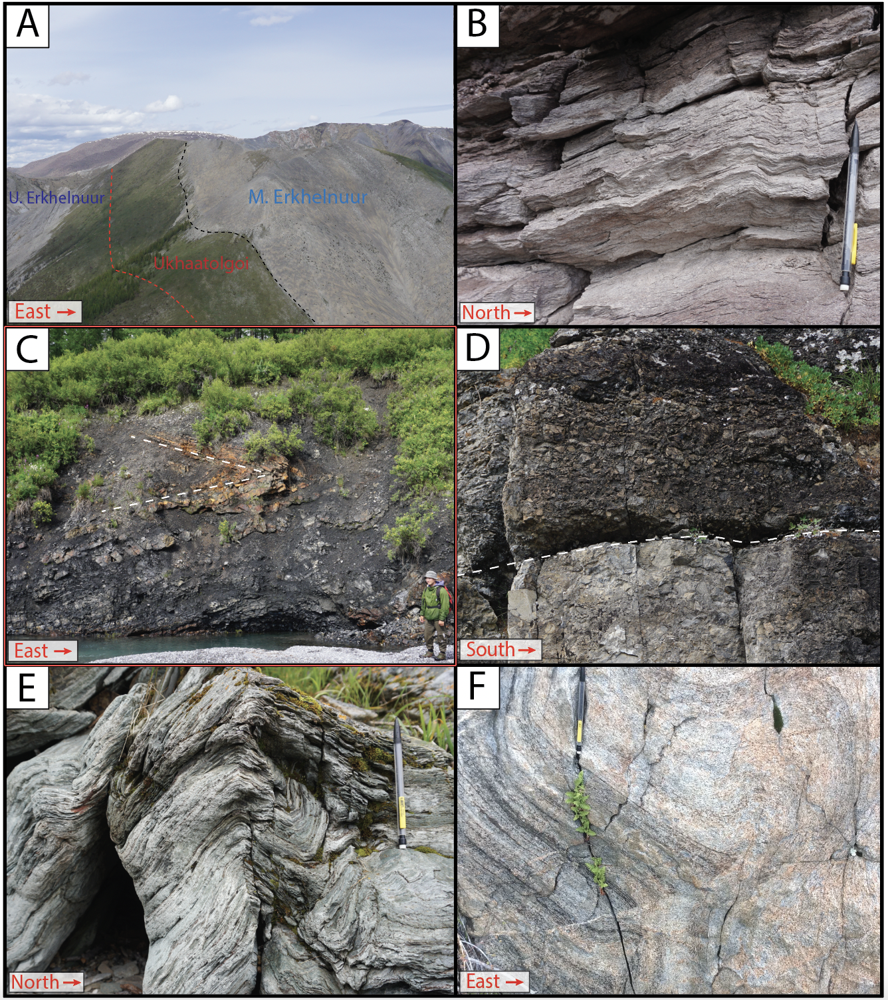

In [10]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig8.png')
fig

## _Figure 9._
* * * 



### LA-ICPMS detrital plots.

* * *
Import LA-ICPMS detrital data.

In [4]:
Ukh_Comp=pd.read_excel('Laser_Data/Khuvsgul_LA_ICPMS_Data_All.xlsx',sheet_name='Ukhaatolgoi_Comp')
EAGC1905=pd.read_excel('Laser_Data/Khuvsgul_LA_ICPMS_Data_All.xlsx',sheet_name='EAGC1905')
EAGC1703=pd.read_excel('Laser_Data/Khuvsgul_LA_ICPMS_Data_All.xlsx',sheet_name='EAGC1703')
Sarkh_Comp=pd.read_excel('Laser_Data/Khuvsgul_LA_ICPMS_Data_All.xlsx',sheet_name='Sarkhoi_Comp')

* * *
Define list of samples to be plotted.

In [6]:
DZSample_List=[Ukh_Comp,EAGC1905,EAGC1703,Sarkh_Comp]
DZSample_List_Names=['Ukhaatolgoi Compilation','EAGC1905 (Kheseen Fm.)','EAGC1703 (Khirvesteg Fm.)','Sarkhoi Compilation']

* * *
Define plot colors

In [7]:
DZcmap = plt.get_cmap('viridis')
DZSample_Colors=DZcmap(np.linspace(0, .5, len(DZSample_List_Names))) 

* * *
Set up discordia filters based on discordia length (Vermeesch, 2018).

Discordia filter used for detrital spectra here are -10<x<15, which equates to an acceptable discordia length range of -2.62 to 5.16.


In [8]:
#Set parameters of Discordia filter, translating to Discordia Length metric of Vermeesch (2018)
Dn10=-2.62 #-10%
D10=3.67 #10%
D15=5.16 #15%
D20=6.7 #20%
D30=10.2 #30%

* * *
Set binwidths for histogram and bandwith for KDE. Binwidth/bandwith is in millions of years.


In [9]:
binwidth=5 

* * *
Calculate KDE's and histograms for detrital zircon data, using 206-238 ages for all analyses that fall within acceptable discordia envelope. Function name: DetritalKDEplot()

In [12]:
#KDE FUNCTION

def DetritalKDEplot(): #define function to trim discordant and reverse discordant ages from detrital data, and generate KDE
    Discard_ndiscord=Detrital.loc[Detrital['discordance'] > Dn10] #remove all ages that are more negatively-discordant than chosen filter.
    Discard_discord=Discard_ndiscord.loc[Detrital['discordance'] < D15] #remove all remaining ages that are more discordant than chosen filter.
    Detritalages=pd.Series.to_numpy(Discard_discord['06_38_age']).reshape(len(Discard_discord['06_38_age']),1) #define and reshape detrital data for KDE function
    xplot = np.linspace(0, 4000, 40000)[:, np.newaxis] #create range of x values to populate with KDE model output
    kde = KernelDensity(kernel='gaussian', bandwidth=binwidth).fit(Detritalages) #define KDE
    log_dens = kde.score_samples(xplot) #populate x values with model output
    
    fig,ax=plt.subplots(figsize=(12, 4))
    ax.hist(Detritalages,bins=np.arange(500,1000, binwidth),alpha=.5,color=detrital_colors)
    ax.set_ylabel("Number of grains",color=detrital_colors)
    ax.xaxis.set_tick_params(labelbottom=False)
    ax.xaxis.grid()
    ax.set_xticklabels([])
    ax2=ax.twinx()
    ax2.fill(xplot,np.exp(log_dens), c='k',alpha=.1,zorder=2)
    numsamples=str((len(Detritalages)))
    ax2.plot(xplot,np.exp(log_dens), c='k',alpha=1,zorder=2, label='n='+numsamples+'') #label with number of samples used to create KDE.
    ax2.set_ylabel(detrital_data_name,color='k',size=15, rotation=270,labelpad=20)
    ax2.yaxis.set_tick_params(labelright=False)
    ax2.set_yticks([])
    plt.xlim(400,1000)
    plt.legend()
    
    plt.savefig('Output/Detrital_Spectra/'+detrital_data_name+'_KDE_Plot_'+str(binwidth)+'ma_bins.pdf')
    

* * *
Loop through all detrital samples to be plotted.

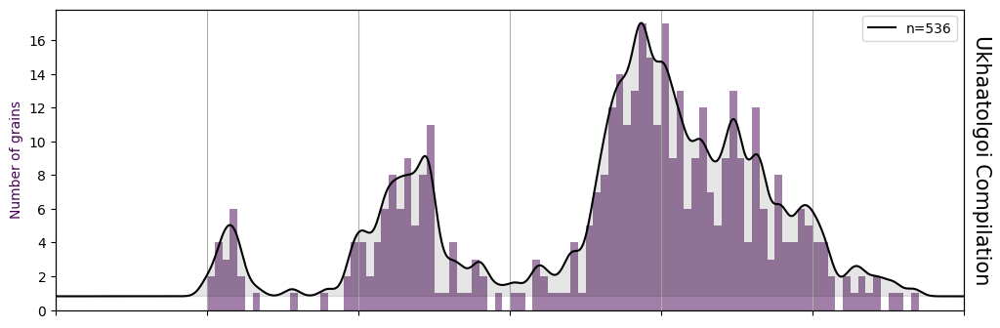

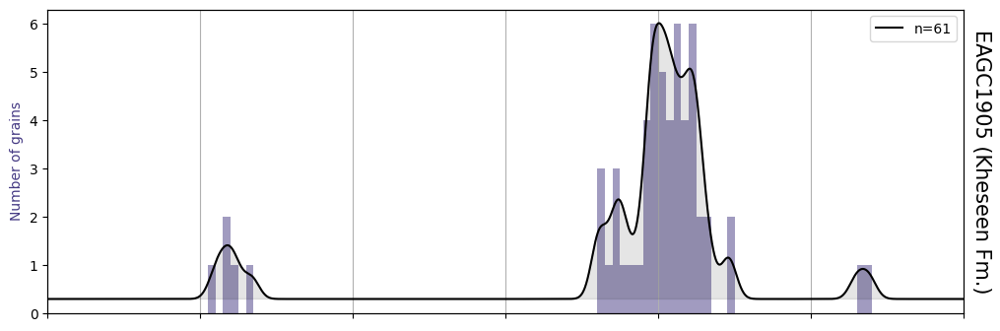

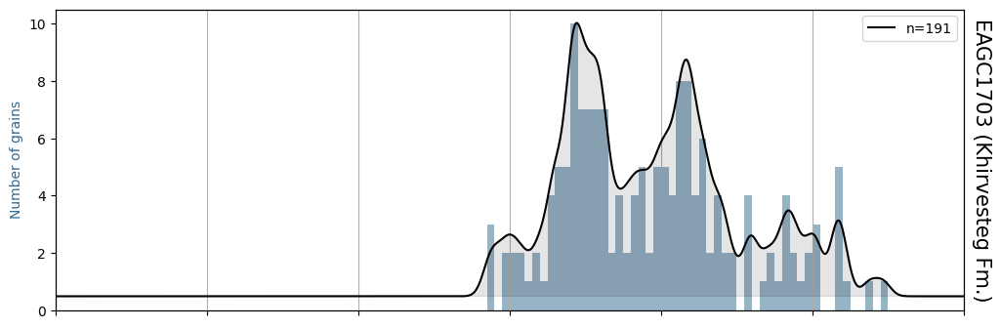

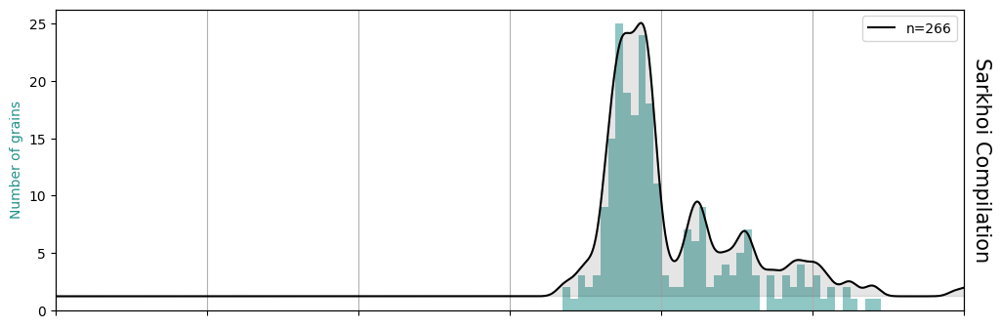

In [13]:
for jj in range(0,len(DZSample_List)): 
    Detrital = DZSample_List[jj]
    detrital_data_name = DZSample_List_Names[jj]
    detrital_colors=DZSample_Colors[jj]
    DetritalKDEplot()


Incorporate into illustrator file; add concordia plots for EAGC1905 MDA
* * * 

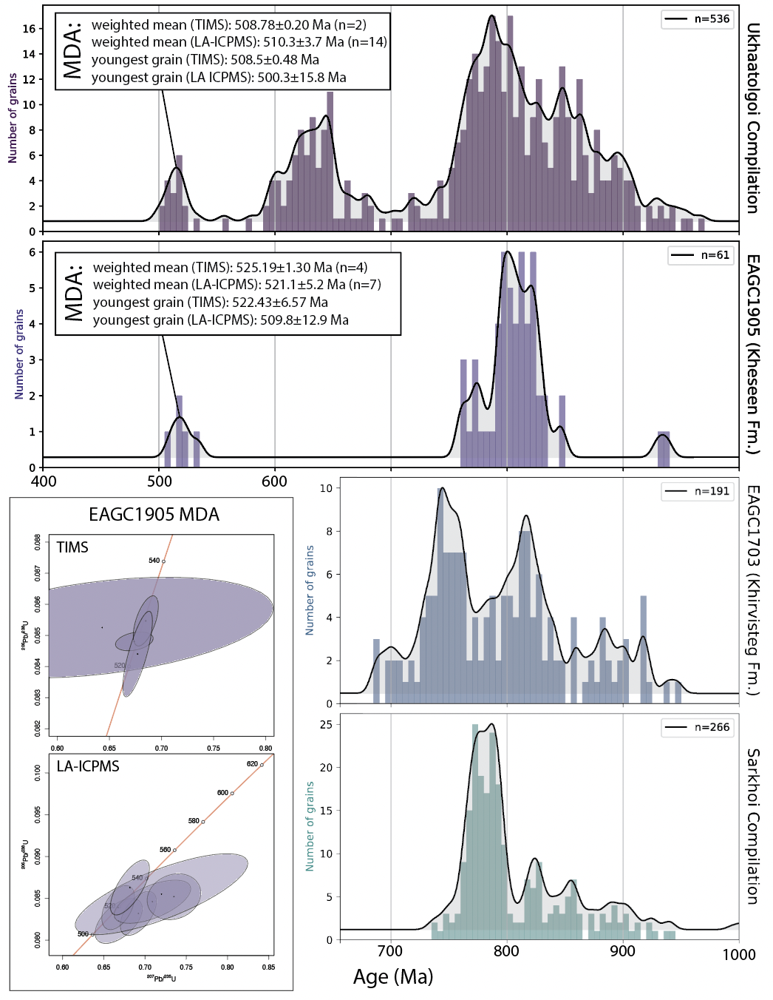

In [19]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig9.png')
fig

## _Figure 10:_ created in Illustrator, pdf only.
* * * 

_All IsoplotR plots incorporated into figure can be found in /Fig_Code/Geochron_Fig_Components/IsoplotR_



_All geochronological data can be found in ~/Tables/TableSI3.xslx_

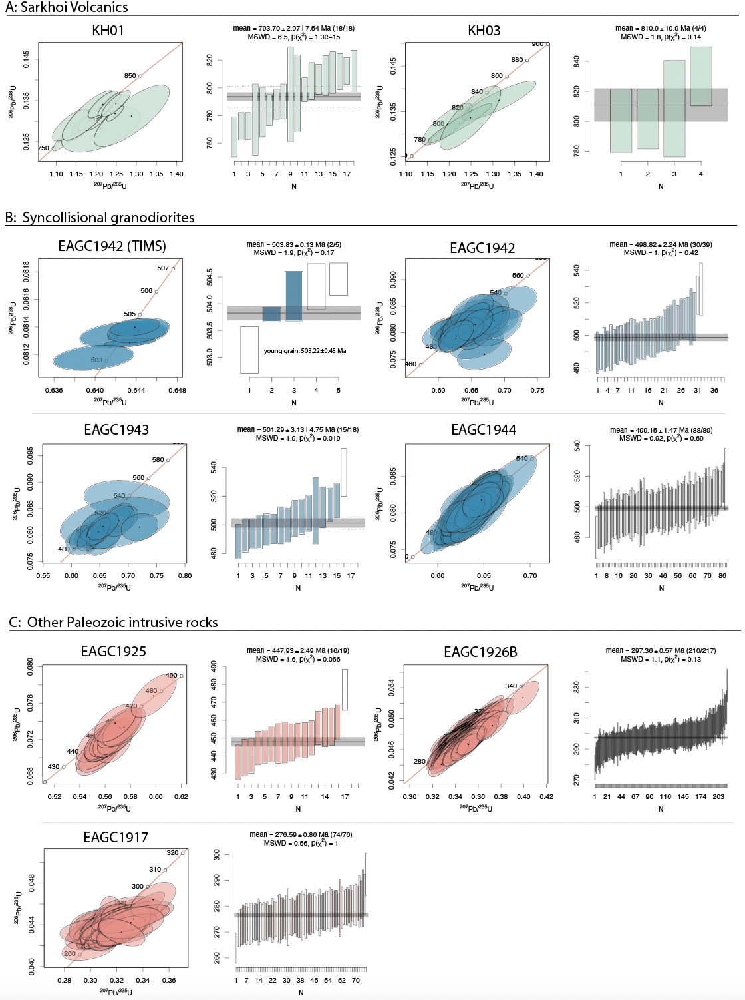

In [20]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig10.png')
fig

## _Figure 11:_ created in Illustrator, pdf only.
* * * 


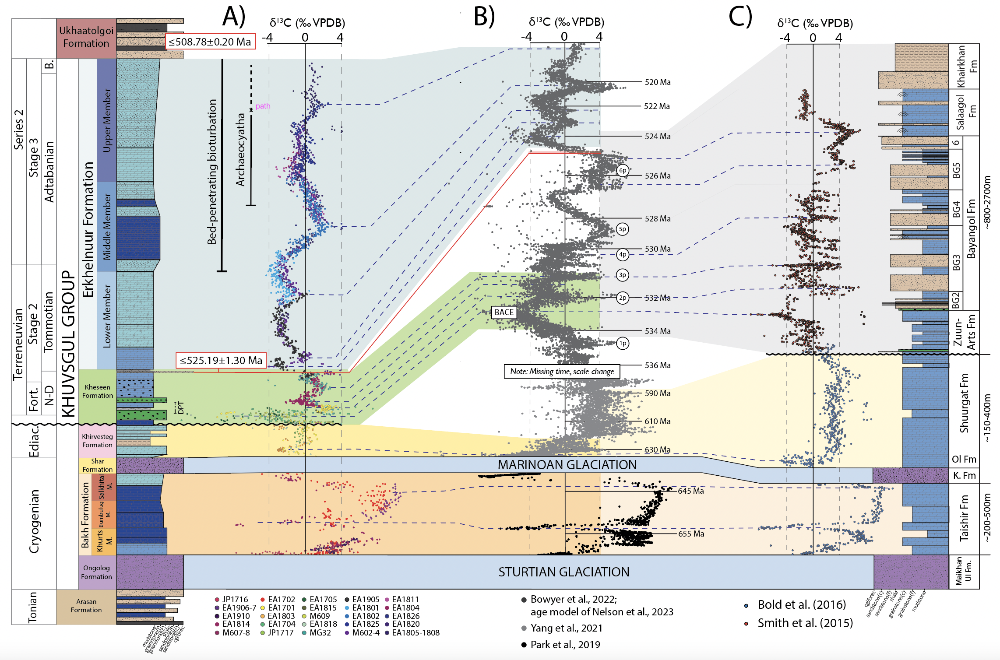

In [28]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig11.png')
fig

## _Figure 12._
* * * 



In [36]:
import pybacktrack
root='/Users/eanttila/Documents/GitHub/Khuvsgul Strat/Fig_Code/Backstrip/'
# Input and output filenames.
input_well_filename = root+'Input/Khuvsgul_lithology.txt'
amended_well_output_filename = root+'Input/Khuvs_lithology_amended.txt'
decompacted_output_filename = root+'Input/Khuvs_lithology_decompacted.txt'

# Read input well file, and write amended well and decompacted results to output files.
pybacktrack.backstrip_and_write_well(
    decompacted_output_filename,
    input_well_filename,
    lithology_filenames=[pybacktrack.PRIMARY_BUNDLE_LITHOLOGY_FILENAME,
                         pybacktrack.EXTENDED_BUNDLE_LITHOLOGY_FILENAME],
    sea_level_model=pybacktrack.BUNDLE_SEA_LEVEL_MODELS['Haq87_SealevelCurve_Longterm'],
    decompacted_columns=[pybacktrack.BACKSTRIP_COLUMN_AGE,
                         pybacktrack.BACKSTRIP_COLUMN_COMPACTED_DEPTH,
                         pybacktrack.BACKSTRIP_COLUMN_COMPACTED_THICKNESS,
                         pybacktrack.BACKSTRIP_COLUMN_DECOMPACTED_THICKNESS,
                         pybacktrack.BACKSTRIP_COLUMN_DECOMPACTED_DENSITY,
                         pybacktrack.BACKSTRIP_COLUMN_DECOMPACTED_SEDIMENT_RATE,
                         pybacktrack.BACKSTRIP_COLUMN_DECOMPACTED_DEPTH,
                         pybacktrack.BACKSTRIP_COLUMN_MIN_TECTONIC_SUBSIDENCE,
                         pybacktrack.BACKSTRIP_COLUMN_MAX_TECTONIC_SUBSIDENCE,
                         pybacktrack.BACKSTRIP_COLUMN_AVERAGE_TECTONIC_SUBSIDENCE,
                         pybacktrack.BACKSTRIP_COLUMN_MIN_WATER_DEPTH,
                         pybacktrack.BACKSTRIP_COLUMN_MAX_WATER_DEPTH,
                         pybacktrack.BACKSTRIP_COLUMN_AVERAGE_WATER_DEPTH,
                         pybacktrack.BACKSTRIP_COLUMN_LITHOLOGY],
    # Might be an extra stratigraphic well layer added from well bottom to ocean basement...
    ammended_well_output_filename=amended_well_output_filename)

backstrip_well_filename = root+'Input/Khuvsgul_lithology.txt'


In [37]:
def plot_tectonic_subsidence(
        decompacted_sections,
        plot_sea_level=False,
        dynamic_topography_model=None,
        gforisos_output=None,
        plot_subsidence_minus_dynamic_topography=False):

    # 'decompacted_sections' is a list of pybacktrack.DecompactedWell.
    # Each decompacted section is a single pybacktrack.DecompactedWell that represents
    # the stratigraphic section of the well when it is decompacted at a particular time
    # (the time of one of its stratigraphic units).
    #
    # Extract the age and tectonic subsidence from each decompacted section in the list.
    ages = [decompacted_section.get_age()
            for decompacted_section in decompacted_sections]
    tectonic_subsidences = [decompacted_section.get_tectonic_subsidence()
            for decompacted_section in decompacted_sections]
    min_max_tectonic_subsidences = [decompacted_section.get_min_max_tectonic_subsidence()
            for decompacted_section in decompacted_sections]
    tectonic_subsidence_uncertainties = [0.5 * (max_tectonic_subsidence - min_tectonic_subsidence)
            for min_tectonic_subsidence, max_tectonic_subsidence in min_max_tectonic_subsidences]
    
    if plot_sea_level:
        # Keep track of the sea level (relative to present day) at each age.
        #
        # NOTE: Positive values represent sea-level rise which is the opposite of depth
        # (which is positive going down).
        # So we need to negate sea level to turn a rise into a depth.
        sea_level_depths = [-decompacted_section.get_sea_level()
                for decompacted_section in decompacted_sections]
    
    if dynamic_topography_model:
        # Keep track of the dynamic topography at each age.
        #
        # NOTE: Positive values represent elevation which is the opposite of subsidence
        # (which is positive going down).
        # So we need to negate dynamic topography to turn an elevation into a depth.
        dynamic_topography_depths = [-dynamic_topography_model.sample(decompacted_section.get_age())
                for decompacted_section in decompacted_sections]

    fig = plt.figure(figsize=(8,8))

    # Plot tectonic subsidence.
    plt.errorbar(
        ages,
        tectonic_subsidences,
        yerr=tectonic_subsidence_uncertainties,
        fmt='-o',
        color='black',
        label='tectonic subsidence',
        linestyle='-',
        linewidth=2.0)

    if plot_sea_level:
        # Plot sea level.
        plt.plot(
            ages,
            sea_level_depths,
            color='blue',
            label='sea level',
            linestyle='-',
            linewidth=2.0)

    if dynamic_topography_model:
        # Plot dynamic topography.
        plt.plot(
            ages,
            dynamic_topography_depths,
            color='red',
            label='dynamic topography',
            linestyle='-',
            linewidth=2.0)
    
    if plot_subsidence_minus_dynamic_topography:
        # Plot tectonic subsidence minus dynamic topography.
        plt.errorbar(
            ages,
            [(tectonic_subsidences[age_index] - dynamic_topography_depths[age_index])
                 for age_index in range(len(ages))],
            yerr=tectonic_subsidence_uncertainties,
            fmt='-o',
            color='magenta',
            label='tectonic subsidence rel. dynamic topography',
            linestyle='-',
            linewidth=2.0)
    
    if gforisos_output:
        for beta_index, (gforisos_ages, gforisos_subsidences) in enumerate(gforisos_output):
            # Plot tectonic subsidence output by gforisos program (for a specific BETA).
            plt.plot(
                gforisos_ages,
                gforisos_subsidences,
                color='green',
                label='gforisos subsidence {0}'.format(beta_index+1),
                linestyle='-',
                linewidth=2.0)

    plt.gca().invert_xaxis()
    plt.gca().invert_yaxis()

    plt.ylabel('Depth (m)', fontsize=12)
    plt.xlabel('Age (Ma)', fontsize=12)
    plt.grid(linestyle='--',alpha=0.5)

    plt.legend(fontsize=10)

    plt.show()

/var/folders/sf/07gqd5t94hlf4rk2x3ky3dkm0000gn/T/ipykernel_12175/2117018456.py:44: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "-o" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(


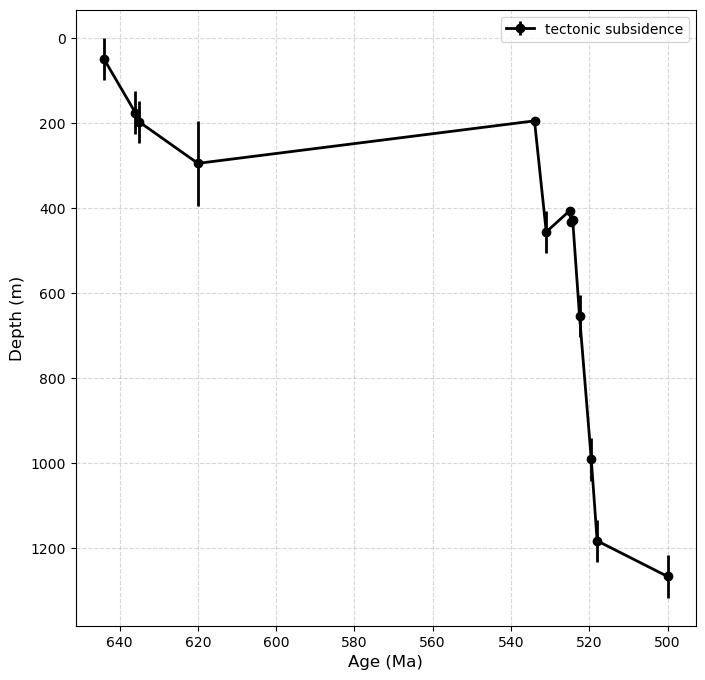

In [38]:
well, decompacted_sections = pybacktrack.backstrip_well(
    input_well_filename,
    pybacktrack.BUNDLE_LITHOLOGY_FILENAMES)

plot_tectonic_subsidence(decompacted_sections)

In [39]:
import warnings

# Ignore user warnings related to well thickness being larger than total sediment thickness.
#
# This happens because the default total sediment thickness grid is not as accurate near continental margins
# like the 'sunrise' drill site (compared to deeper ocean basins).
warnings.filterwarnings("ignore", "Well thickness .* is larger than the total sediment thickness")

# Ignore user warnings related to dynamic topography sampling.
#
# This happens when the age of interpolated dynamic topography grids are older than the crust at the drill site location.
warnings.filterwarnings("ignore", "Dynamic topography model .* cannot")

In [40]:
def get_decompacted_sediment_depths(
        well,
        decompacted_sections):
    """
    Return the decompacted sediment depths over time, and
    sea-level, surface sediment depth and tectonic subsidence.
    """

    # 'decompacted_sections' is a list of pybacktrack.DecompactedWell.
    # Each decompacted section is a single pybacktrack.DecompactedWell that represents
    # the stratigraphic section of the well when it is decompacted at a particular time
    # (the time of one of its stratigraphic units).
    #
    # Extract the age, water depth, tectonic subsidence and
    # decompacted depths from each decompacted section in the list.
    ages = []
    sea_level_depths = []
    surface_sediment_depths = []
    tectonic_subsidences = []
    dynamic_topography_depths = []

    # The total number of stratigraphic layers at present day.
    num_stratigraphic_units = len(well.stratigraphic_units)
    # Each stratigraphic layer will have its own depth vs age curve.
    # Start with an empty list for each layer.
    all_stratigraphic_unit_depths = [[] for i in range(num_stratigraphic_units)]

    # Each successive decompacted section involves stripping off a stratigraphic layer.
    for decompacted_section in decompacted_sections:
        # Keep track of the ages of the top of each stratigraphic layer.
        age = decompacted_section.get_age()
        ages.append(age)

        # Keep track of the sea level (relative to present day) at each age.
        #
        # NOTE: Positive values represent sea-level rise which is the opposite of depth
        # (which is positive going down).
        # So we need to negate sea level to turn a rise into a depth.
        sea_level = decompacted_section.get_sea_level()
        sea_level_depth = -sea_level
        sea_level_depths.append(sea_level_depth)

        # Keep track of the surface sediment depth at each age.
        water_depth = decompacted_section.get_water_depth()
        surface_sediment_depth = sea_level_depth + water_depth
        surface_sediment_depths.append(surface_sediment_depth)

        # Keep track of the tectonic subsidence at each age.
        tectonic_subsidence = decompacted_section.get_tectonic_subsidence()
        tectonic_subsidences.append(tectonic_subsidence)

        # The number of decompacted stratigraphic layers decreases by one each loop iteration.
        num_decompacted_stratigraphic_units = len(decompacted_section.decompacted_stratigraphic_units)

        # The depth of the current surface layer starts at the surface sediment depth.
        total_decompacted_depth = surface_sediment_depth

        # Iterate over the stratigraphic layers that have already been removed.
        # We'll just give them the current surface sediment depth so
        # we can easily fill colours between curves below.
        stratigraphic_unit_index = 0
        while stratigraphic_unit_index < num_stratigraphic_units - num_decompacted_stratigraphic_units:
            all_stratigraphic_unit_depths[stratigraphic_unit_index].append(surface_sediment_depth)
            stratigraphic_unit_index += 1

        # Iterate over the stratigraphic layers still existing at the current time.
        # Each layer has a decompacted thickness which adds to the decompacted depth.
        for decompacted_stratigraphic_unit in decompacted_section.decompacted_stratigraphic_units:
            total_decompacted_depth += decompacted_stratigraphic_unit.decompacted_thickness
            all_stratigraphic_unit_depths[stratigraphic_unit_index].append(total_decompacted_depth)
            stratigraphic_unit_index += 1
        
    return (ages, sea_level_depths, surface_sediment_depths,
            tectonic_subsidences, all_stratigraphic_unit_depths)

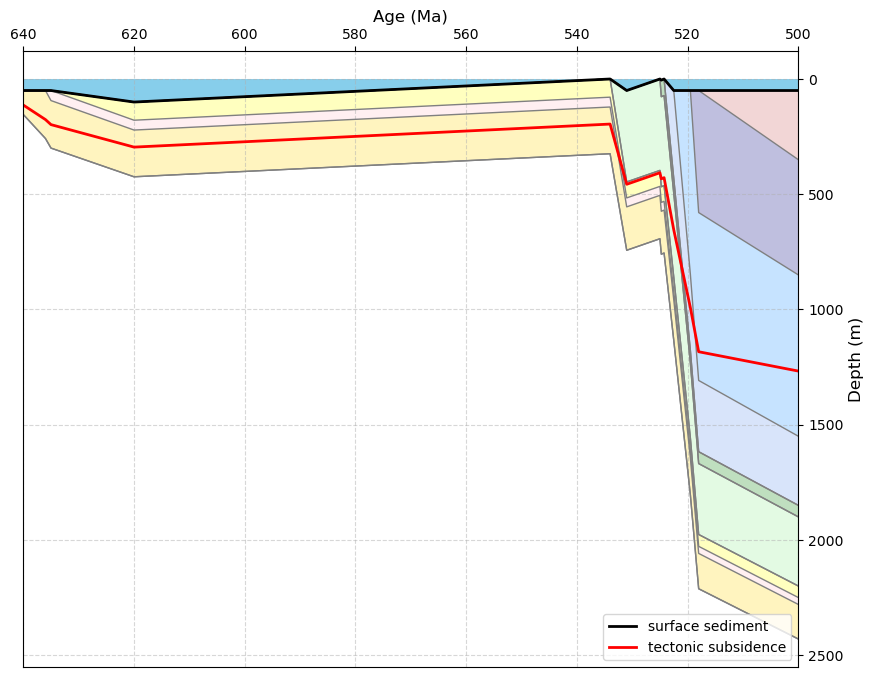

In [41]:
%matplotlib inline

import matplotlib.pyplot as plt

# Choose a colour for each stratigraphic unit.
stratigraphic_unit_colours = [
    'IndianRed', 'navy', 'dodgerblue', 'cornflowerblue','k', 'green', 'k', 'lightgreen', 'k', 'yellow','pink','gold']

def plot_decompacted_sediment_depths(
        ages,
        sea_level_depths,
        surface_sediment_depths,
        tectonic_subsidences,
        all_stratigraphic_unit_depths):
    """
    Plot the decompacted sediment depths over time, and
    sea-level, surface sediment depth and tectonic subsidence.
    """

    # The total number of stratigraphic layers at present day.
    num_stratigraphic_units = len(all_stratigraphic_unit_depths)
    
    plt.figure(figsize=(10,8))
   

    for stratigraphic_unit_index in range(num_stratigraphic_units):
        # Plot a grey line at the top of the current stratigraphic unit.
        plt.plot(
            ages,
            all_stratigraphic_unit_depths[stratigraphic_unit_index],
            color='grey',
            linewidth=1.0)
        # Fill the current stratigraphic layer with a colour.
        plt.fill_between(
            ages,
            (all_stratigraphic_unit_depths[stratigraphic_unit_index-1]
                 if stratigraphic_unit_index > 0
                 else surface_sediment_depths),
            all_stratigraphic_unit_depths[stratigraphic_unit_index],
            facecolor=stratigraphic_unit_colours[stratigraphic_unit_index % len(stratigraphic_unit_colours)], alpha=.25)

    # Fill blue from sea-level depth down to surface sediment depth to indicate water.
    plt.fill_between(
        ages,
        sea_level_depths,
        surface_sediment_depths,
        facecolor='skyblue')

    # Plot surface sediment depth.
    plt.plot(
        ages,
        surface_sediment_depths,
        color='black',
        label='surface sediment',
        linestyle='-',
        linewidth=2.0)

    # Plot tectonic subsidence.
    plt.plot(
        ages,
        tectonic_subsidences,
        color='red',
        label='tectonic subsidence',
        linestyle='-',
        linewidth=2.0)


    plt.gca().invert_xaxis()
    plt.gca().invert_yaxis()

    plt.ylabel('Depth (m)', fontsize=12)
    plt.xlabel('Age (Ma)', fontsize=12)
    plt.grid(linestyle='--',alpha=0.5)
    ax=plt.gca()
    ax.yaxis.set_label_position("right")
    ax.yaxis.tick_right()
    ax.xaxis.set_label_position("top")
    ax.xaxis.tick_top()
    plt.xlim(640,500)
    
    plt.legend(fontsize=10,loc='lower right')
    plt.savefig(root+'Output/Khuvsgul_subsidence.pdf')
    plt.show()
    

    
well, decompacted_sections = pybacktrack.backstrip_well(
    backstrip_well_filename,
    pybacktrack.BUNDLE_LITHOLOGY_FILENAMES)


# Retrieve and plot the decompacted sediment depths, etc.
plot_decompacted_sediment_depths(*get_decompacted_sediment_depths(well, decompacted_sections))



_Add cylindrical tectonic cartoon and annotations in Illustrator_
* * * 

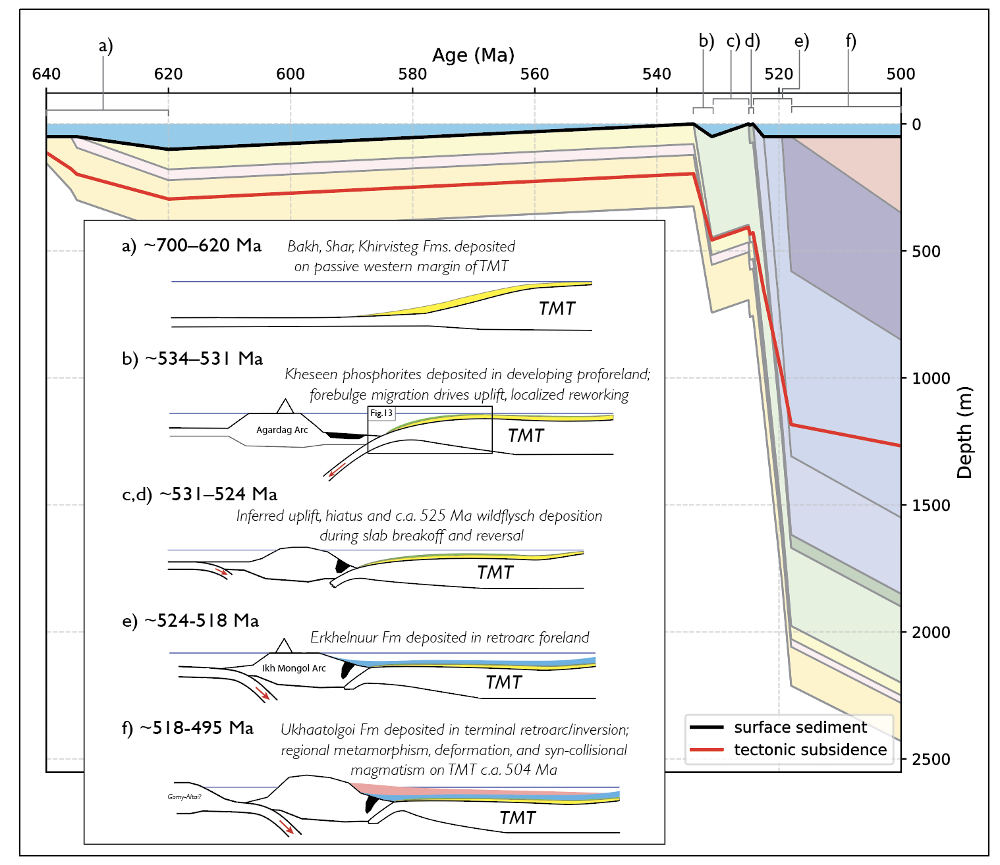

In [30]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig12.png')
fig

## _Figure 13:_ created in Illustrator, pdf only.
* * * 

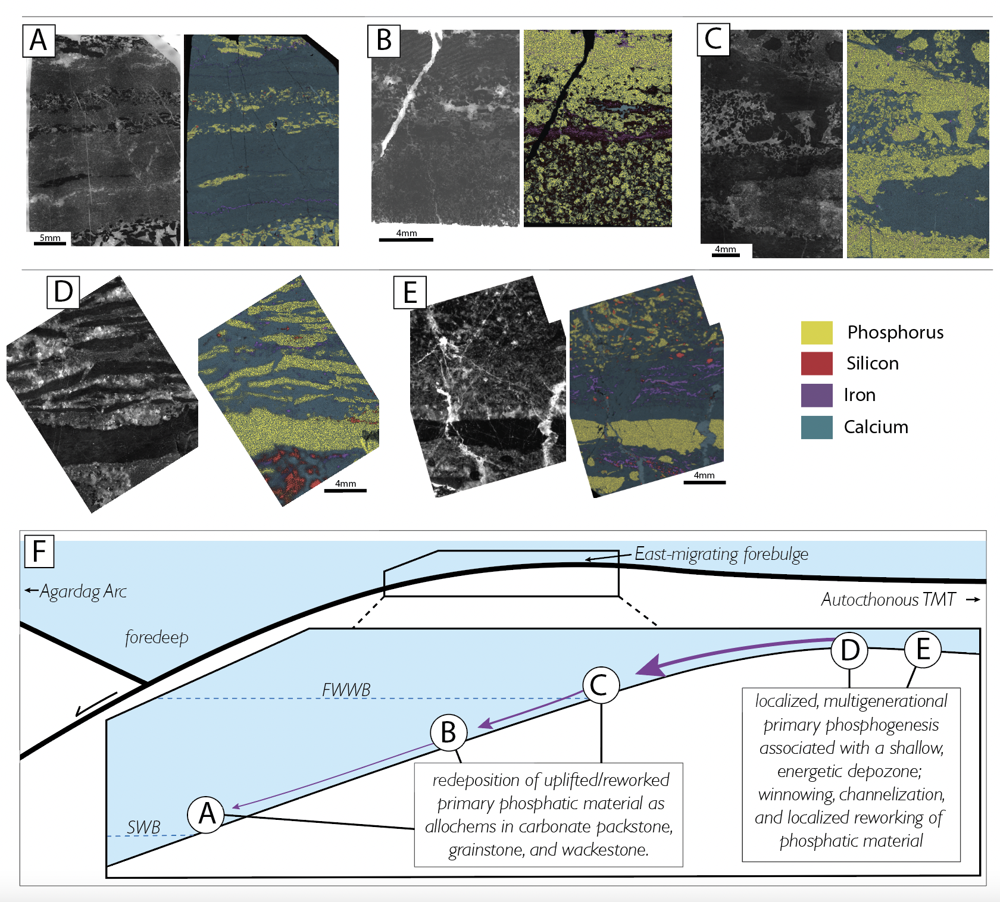

In [33]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig13.png')
fig

* * * 
## _Figure 14_
### Bar plot of ages of E-C phosphorites and DPT fossil assemblages from around the world

* * *

In [42]:
#linear plot
#data=['Name',MaxAge,MaxAgeUncert,MinAge,MinAgeuncert,Region]#Reference
P_Comp=pd.read_excel('P_Compilation_Data/Global_Compilation.xlsx')

In [43]:
Mi_MinEr=P_Comp['Min_Age']-P_Comp['Min_Age_2sigma']
Mi_MaxEr=P_Comp['Min_Age']+P_Comp['Min_Age_2sigma']
Ma_MinEr=P_Comp['Max_Age']-P_Comp['Max_Age_2sigma']
Ma_MaxEr=P_Comp['Max_Age']+P_Comp['Max_Age_2sigma']
    
#Create colormap
color_input_list=P_Comp['Region']
toset=set(color_input_list)
Pcmap = plt.get_cmap('viridis')
Pcolor=Pcmap(np.linspace(.1, .8, len(toset))) 
regcode=0
colorp='k'

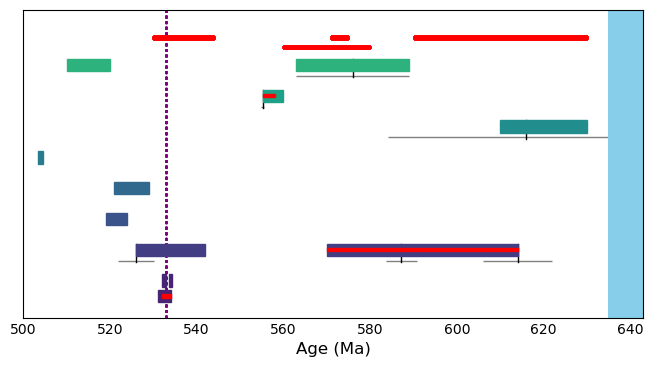

In [44]:
PCompilation=plt.figure(figsize=(8,4))#set figure dimensions
#Phosphorite duration   
for ii in range(0,len(P_Comp)):
    
    if P_Comp['Region'][ii] =='TMM':
        colorp=Pcolor[0]
        regcode=1
    if P_Comp['Region'][ii] =='TMM1':
        colorp=Pcolor[0]
        regcode=0.5
    if P_Comp['Region'][ii] == 'SouthChina':
        colorp=Pcolor[1]
        regcode=2
    if P_Comp['Region'][ii] == 'WCAOB':
        colorp=Pcolor[2]
        regcode=3 
    if P_Comp['Region'][ii] == 'India':
        colorp=Pcolor[3]
        regcode=4 
    if P_Comp['Region'][ii] == 'Australia':
        colorp=Pcolor[4]
        regcode=5     
    if P_Comp['Region'][ii] == 'E. Brazil':
        colorp=Pcolor[5]
        regcode=6
    if P_Comp['Region'][ii] == 'W. Brazil':
        colorp=Pcolor[6]
        regcode=7
    if P_Comp['Region'][ii] == 'Africa':
        colorp=Pcolor[7]
        regcode=8       
    plt.axvspan(P_Comp['Min_Age'][ii],P_Comp['Max_Age'][ii],((regcode)*.10),((regcode)*.10)+.04 ,color=colorp,zorder=4)
    

    #min age constraints
    if P_Comp['ConstraintTypeMin'][ii]=='absolute':
        alphapoint=1
    if P_Comp['ConstraintTypeMin'][ii]=='rel':
        alphapoint=0
    plt.axvline(P_Comp['Min_Age'][ii],((regcode)*.10)-.02,((regcode)*.10)+.04, color='k', lw=1, alpha=alphapoint, zorder=2)
   #uncertainties
    ucolor='gray'
    plt.axvspan(Mi_MinEr[ii],Mi_MaxEr[ii],((regcode)*.10)-.0151,((regcode)*.10)-.015 ,color=ucolor,zorder=1)

    #max age constraints
    if P_Comp['ConstraintTypeMax'][ii]=='absolute':
        alphapoint=1
    if P_Comp['ConstraintTypeMax'][ii]=='rel':
        alphapoint=0
    plt.axvline(P_Comp['Max_Age'][ii],((regcode)*.10)-.02,((regcode)*.10)+.04, color='k', lw=1, alpha=alphapoint, zorder=2)
    #uncertainties
    plt.axvspan(Ma_MinEr[ii],Ma_MaxEr[ii],((regcode)*.10)-.0151,((regcode)*.10)-.015 ,color=ucolor,zorder=1)


    
    #other ages
    plt.axvline(P_Comp['OtherAge'][ii],((regcode)*.10)-.02,((regcode)*.10)+.04, color='k', lw=1, alpha=1, zorder=2)
    #uncertainties
    plt.axvspan(P_Comp['OtherAge'][ii]-P_Comp['OtherAge_2s'][ii],P_Comp['OtherAge'][ii]+P_Comp['OtherAge_2s'][ii],((regcode)*.10)-.0151,((regcode)*.10)-.015 ,color=ucolor,zorder=1)


    #DPT extents
    plt.axvspan(P_Comp['Dsht Min'][ii],P_Comp['Dsht Max'][ii],((regcode)*.10)+.015,((regcode)*.10)+.025 ,color='r',zorder=4)
    
    #non-Phosphorite DPT extents
    plt.axvspan(P_Comp['DSHTnoPmin'][16],P_Comp['DSHTnoPmax'][16],((8.9)*.10)+.015,((8.9)*.10)+.023 ,color='r',zorder=4)
    plt.axvspan(P_Comp['DSHTnoPmin'][13],P_Comp['DSHTnoPmax'][13],((8.9)*.10)+.015,((8.9)*.10)+.023 ,color='r',zorder=4)
    plt.axvspan(P_Comp['DSHTnoPmin'][14],P_Comp['DSHTnoPmax'][14],((8.9)*.10)+.015,((8.9)*.10)+.023 ,color='r',zorder=4)
    plt.axvspan(P_Comp['DSHTnoPmin'][15],P_Comp['DSHTnoPmax'][15],((8.6)*.10)+.015,((8.6)*.10)+.023 ,color='r',zorder=4)
    
    #Color Blocks
    plt.axvline(533, zorder=1, color='purple', lw=1,dashes=(2,2))
    plt.axvspan(635,645,color='skyblue',zorder=2)
    
    #prettify
    plt.xlim(500,643)
    plt.tick_params(labelleft=False, length=0)
    plt.xlabel('Age (Ma)',size='12')
     

    
plt.savefig('Output/P_Comp/Phosphorite_Global_Comp.pdf')
    

_Add annotations in Illustrator_
* * * 

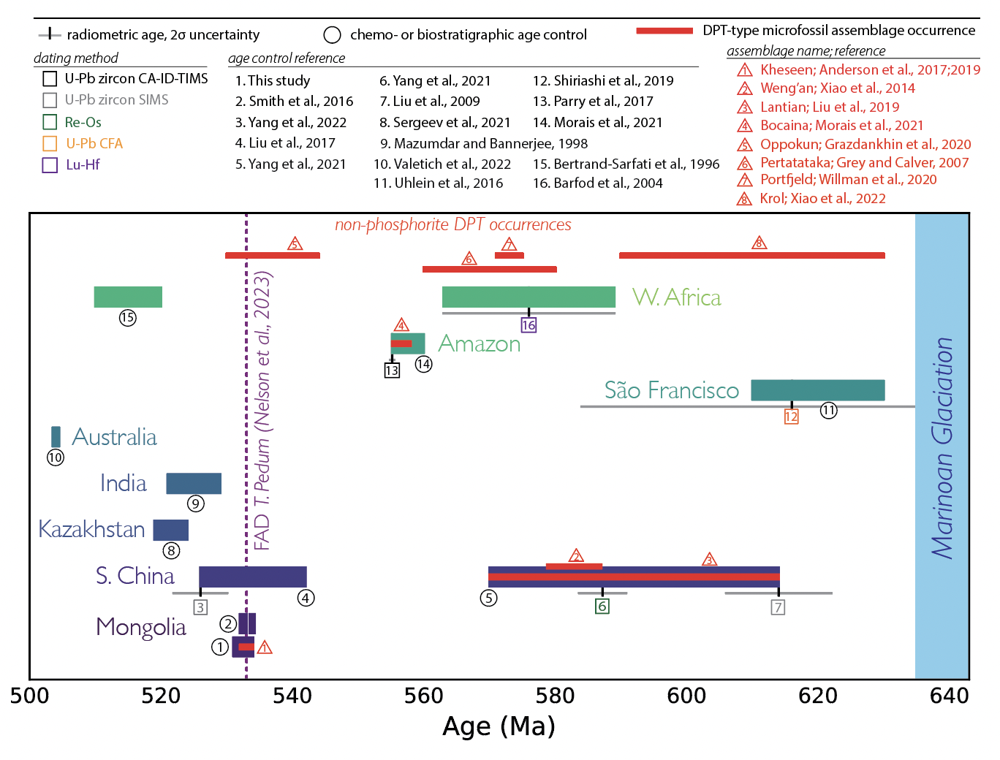

In [45]:
fig = Image(filename='Figures/Manuscript_Figures/Submission_files/Png/Anttila_Fig14.png')
fig